In [1]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.calibration import LabelEncoder

In [2]:
alternative = pd.read_csv('training-data/alternative.csv')
blues = pd.read_csv('training-data/blues.csv')
classical = pd.read_csv('training-data/classical.csv')
comedy = pd.read_csv('training-data/comedy.csv')
folk = pd.read_csv('training-data/folk.csv')
hiphop = pd.read_csv('training-data/hip-hop.csv')
jazz = pd.read_csv('training-data/jazz.csv')
opera = pd.read_csv('training-data/opera.csv')
pop = pd.read_csv('training-data/pop.csv')
rnb = pd.read_csv('training-data/rb.csv')

df = pd.concat([alternative, blues, classical, comedy, folk, hiphop, jazz, opera, pop, rnb], axis=0) #concatenate genre dataframes
df.shape

(50000, 19)

In [3]:
#get first 5 rows of the dataframe

df.head()

,instance_id,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,genre
0,134768,Freddie Gibbs,Triple Threat,12NwYmQT1Mm7gkrCjIuq0d,45,0.02520,0.850,178422,0.412,0.00000,D,0.0948,-7.845,Major,0.2360,130.99,04-Apr,0.663,Alternative
1,97297,Three Days Grace,No More,4yDs61mzPcTod9qrBUE3H9,45,0.00261,0.271,225493,0.916,0.00000,F#,0.1560,-3.141,Minor,0.0581,197.817,04-Apr,0.286,Alternative
2,88412,Solange,Don't You Wait,0AmkrjMDff4ICVNxQhppZA,45,0.27900,0.833,245907,0.579,0.69200,C,0.0997,-6.568,Major,0.0800,?,04-Apr,0.514,Alternative
3,172572,Amy Grant,"Baby, Baby",25AmLrQC1b3Hz9FUGZXF1S,58,0.42600,0.702,236973,0.901,0.00153,C#,0.0368,-4.450,Major,0.0264,97.862,04-Apr,0.919,Alternative
4,194415,empty_field,Livin Right,6KmnejQFYdWUVUJh6zwEce,46,0.00114,0.539,209760,0.915,0.00000,C#,0.0675,-4.251,Minor,0.0601,88.051,04-Apr,0.435,Alternative


In [4]:
#get featurename, count, dtype

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50000 entries, 0 to 4999
Data columns (total 19 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   instance_id       50000 non-null  int64  
 1   artist_name       50000 non-null  object 
 2   track_name        50000 non-null  object 
 3   track_id          50000 non-null  object 
 4   popularity        50000 non-null  int64  
 5   acousticness      50000 non-null  float64
 6   danceability      50000 non-null  float64
 7   duration_ms       50000 non-null  int64  
 8   energy            50000 non-null  float64
 9   instrumentalness  50000 non-null  float64
 10  key               50000 non-null  object 
 11  liveness          50000 non-null  float64
 12  loudness          50000 non-null  float64
 13  mode              50000 non-null  object 
 14  speechiness       50000 non-null  float64
 15  tempo             50000 non-null  object 
 16  time_signature    50000 non-null  object 
 17 

In [5]:
#check for missing values in dataset - cp from as2

totalMissingColumn = df.isnull().sum() #total missing values in dataset

df_length = len(df) #length of dataset
missingValues = (df.isnull().sum()/df_length) * 100 #percentage of missing values in dataset
missingValues = missingValues.sort_values(ascending=False) #sort missing values in descending order
missingValues = missingValues[missingValues > 0] #missing values greater than 0
missingValues = pd.DataFrame(missingValues.values, missingValues.index) #convert to dataframe

print("Missing Values:")
print(totalMissingColumn)
print("\nFeatures with percentage missing:")
print(missingValues)

#identified no missing data at all

Missing Values:
instance_id         0
artist_name         0
track_name          0
track_id            0
popularity          0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
speechiness         0
tempo               0
time_signature      0
valence             0
genre               0
dtype: int64

Features with percentage missing:
Empty DataFrame
Columns: [0]
Index: []


In [6]:
# look at the values in each feature 

for col in df.columns:
    print(df[col].value_counts())
    print()
    
# can identify missing columns for these features:
# - artist_name (empty_field -> 9943)
# - duration_ms (-1 -> 10114)
# - instrumentalness (0.000000 -> 16915)
# - tempo (? -> 7501)
# - time_signature (0/4 -> 3)

instance_id
134768    1
25400     1
20923     1
103622    1
188793    1
         ..
143414    1
204039    1
139551    1
124944    1
108923    1
Name: count, Length: 50000, dtype: int64

artist_name
empty_field                  9943
Giuseppe Verdi                652
Giacomo Puccini               563
Richard Wagner                393
Wolfgang Amadeus Mozart       346
                             ... 
The Cave Singers                1
Nancy Sinatra                   1
Marissa Nadler                  1
Wingnut Dishwashers Union       1
J-Sol                           1
Name: count, Length: 6516, dtype: int64

track_name
Home                                  22
You                                   19
Smile                                 18
Stay                                  16
Trouble                               15
                                      ..
Timeshare troubles - Live              1
Spanish Girls                          1
El De Los Mirreyes Y Los Albañiles     1
Meowmin

In [7]:
# descriptive statistics for the dataset

df.describe()

,instance_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,valence
count,50000.00000,50000.000000,50000.000000,50000.000000,5.000000e+04,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000
mean,118922.89754,41.670020,0.474821,0.533403,1.960065e+05,0.515805,0.149052,0.244182,-11.013448,0.166576,0.419746
std,57198.25002,18.496416,0.376703,0.188077,1.566169e+05,0.273039,0.300495,0.234041,6.706273,0.255489,0.248419
min,20004.00000,0.000000,0.000001,0.058200,-1.000000e+00,0.000243,0.000000,0.009670,-47.599000,0.022600,0.000000
25%,69247.75000,29.000000,0.080100,0.406000,1.187925e+05,0.296000,0.000000,0.099600,-14.150000,0.038200,0.210000
50%,118822.50000,44.000000,0.442000,0.546000,2.044335e+05,0.543000,0.000066,0.133000,-8.906000,0.052200,0.400000
75%,168614.25000,55.000000,0.867000,0.672000,2.593330e+05,0.735000,0.046800,0.299000,-6.161000,0.141000,0.607000
max,217850.00000,99.000000,0.996000,0.980000,5.552917e+06,0.998000,0.994000,1.000000,3.744000,0.965000,0.986000


In [8]:
# get understanding of numerical and categorical features in dataset

n_instances = df.shape[0] #num instances
n_features = df.shape[1] # num features

numerical_int = df.select_dtypes(include='number')  # select num features
categorical_int = df.select_dtypes(include='object') # select cat features

numerical_cnt = numerical_int.shape[1]  # num num features
categorical_cnt = categorical_int.shape[1] # num cat features

print("Num Instances: ", n_instances)
print("Num Features: ", n_features)
print("Num Categorical: ", categorical_cnt)
print("Num Numerical: ", numerical_cnt)

Num Instances:  50000
Num Features:  19
Num Categorical:  8
Num Numerical:  11


In [9]:
# identify numerical and categorical feature names

print("Numerical Columns:")
print(numerical_int.columns)
print("\nCategorical Columns:")
print(categorical_int.columns)

Numerical Columns:
Index(['instance_id', 'popularity', 'acousticness', 'danceability',
       'duration_ms', 'energy', 'instrumentalness', 'liveness', 'loudness',
       'speechiness', 'valence'],
      dtype='object')

Categorical Columns:
Index(['artist_name', 'track_name', 'track_id', 'key', 'mode', 'tempo',
       'time_signature', 'genre'],
      dtype='object')


In [10]:
df = df.drop(['artist_name', 'track_name', 'instance_id', 'track_id'], axis=1) #drop columns (categorical)
df.shape

(50000, 15)

In [11]:
# combine key and mode together based on findings and they are related in music theory

df['key_mode'] = df['key'].astype(str) + df['mode'].astype(str) #combine key mode columns -> create new column key_mode
df = df.drop(['key', 'mode'], axis=1) #drop key mode columns
df

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,time_signature,valence,genre,key_mode
0,45,0.02520,0.850,178422,0.412,0.000000,0.0948,-7.845,0.2360,130.99,04-Apr,0.663,Alternative,DMajor
1,45,0.00261,0.271,225493,0.916,0.000000,0.1560,-3.141,0.0581,197.817,04-Apr,0.286,Alternative,F#Minor
2,45,0.27900,0.833,245907,0.579,0.692000,0.0997,-6.568,0.0800,?,04-Apr,0.514,Alternative,CMajor
3,58,0.42600,0.702,236973,0.901,0.001530,0.0368,-4.450,0.0264,97.862,04-Apr,0.919,Alternative,C#Major
4,46,0.00114,0.539,209760,0.915,0.000000,0.0675,-4.251,0.0601,88.051,04-Apr,0.435,Alternative,C#Minor
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,43,0.09780,0.823,188108,0.619,0.000000,0.0929,-9.820,0.2110,147.985,04-Apr,0.163,R&B,C#Major
4996,73,0.49100,0.772,-1,0.256,0.006120,0.1440,-8.545,0.0481,118.902,03-Apr,0.357,R&B,GMinor
4997,43,0.32400,0.638,207680,0.761,0.000000,0.0624,-6.455,0.3020,130.213,04-Apr,0.457,R&B,G#Major
4998,52,0.09610,0.300,241692,0.431,0.000012,0.1140,-5.314,0.0299,148.317,04-Apr,0.221,R&B,D#Major


In [12]:
df['tempo'] = pd.to_numeric(df['tempo'], errors='coerce') #convert tempo to numeric as it is a numerical feature

# create numerical and cateogrical dataframes and check for feature types in them

numerical = df.select_dtypes(include='number')
categorical = df.select_dtypes(include='object')

print("Numerical Columns:")
print(numerical.columns)
print("\nCategorical Columns:")
print(categorical.columns)

Numerical Columns:
Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence'],
      dtype='object')

Categorical Columns:
Index(['time_signature', 'genre', 'key_mode'], dtype='object')


In [13]:
numerical.dtypes

popularity            int64
acousticness        float64
danceability        float64
duration_ms           int64
energy              float64
instrumentalness    float64
liveness            float64
loudness            float64
speechiness         float64
tempo               float64
valence             float64
dtype: object

In [14]:
# get top 5 rows of numerical dataframe

numerical.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
0,45,0.02520,0.850,178422,0.412,0.00000,0.0948,-7.845,0.2360,130.990,0.663
1,45,0.00261,0.271,225493,0.916,0.00000,0.1560,-3.141,0.0581,197.817,0.286
2,45,0.27900,0.833,245907,0.579,0.69200,0.0997,-6.568,0.0800,NaN,0.514
3,58,0.42600,0.702,236973,0.901,0.00153,0.0368,-4.450,0.0264,97.862,0.919
4,46,0.00114,0.539,209760,0.915,0.00000,0.0675,-4.251,0.0601,88.051,0.435


In [15]:
# print mean, median, mode, standard deviation, variance and range for numerical features

mean_values = numerical.mean()
print("Mean Values:")
print(mean_values)

median_values = numerical.median()
print("\nMedian Values:")
print(median_values)

mode_values = numerical.mode().iloc[0]
print("\nMode Values:")
print(mode_values)

std_dev = numerical.std()
print("\nStandard Deviation:")
print(std_dev)

variance = numerical.var()
print("\nVariance:")
print(variance)

range_values = numerical.max() - numerical.min()
print("\nRange:")
print(range_values)

Mean Values:
popularity              41.670020
acousticness             0.474821
danceability             0.533403
duration_ms         196006.493060
energy                   0.515805
instrumentalness         0.149052
liveness                 0.244182
loudness               -11.013448
speechiness              0.166576
tempo                  113.681170
valence                  0.419746
dtype: float64

Median Values:
popularity              44.000000
acousticness             0.442000
danceability             0.546000
duration_ms         204433.500000
energy                   0.543000
instrumentalness         0.000066
liveness                 0.133000
loudness                -8.906000
speechiness              0.052200
tempo                  110.043000
valence                  0.400000
dtype: float64

Mode Values:
popularity           49.0000
acousticness          0.9950
danceability          0.5790
duration_ms          -1.0000
energy                0.6210
instrumentalness      0.0000
liven

In [16]:
# create correlation matrix for numerical features

corr = numerical.corr()
corr

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
popularity,1.000000,-0.580503,0.473593,-0.066448,0.359804,-0.232497,-0.305581,0.532263,-0.253954,0.197416,0.238476
acousticness,-0.580503,1.000000,-0.469053,0.049742,-0.683391,0.300051,0.169976,-0.699495,0.188816,-0.262275,-0.373630
danceability,0.473593,-0.469053,1.000000,-0.139272,0.410504,-0.341960,-0.023363,0.521791,0.149198,0.070415,0.534298
duration_ms,-0.066448,0.049742,-0.139272,1.000000,-0.061534,0.113415,-0.002254,-0.076185,-0.035317,-0.028427,-0.115210
energy,0.359804,-0.683391,0.410504,-0.061534,1.000000,-0.380902,0.246308,0.812908,0.263411,0.187683,0.446253
instrumentalness,-0.232497,0.300051,-0.341960,0.113415,-0.380902,1.000000,-0.176273,-0.471876,-0.221183,-0.091872,-0.208982
liveness,-0.305581,0.169976,-0.023363,-0.002254,0.246308,-0.176273,1.000000,0.023698,0.671640,-0.109692,0.005693
loudness,0.532263,-0.699495,0.521791,-0.076185,0.812908,-0.471876,0.023698,1.000000,0.035961,0.217593,0.422711
speechiness,-0.253954,0.188816,0.149198,-0.035317,0.263411,-0.221183,0.671640,0.035961,1.000000,-0.131694,0.019304
tempo,0.197416,-0.262275,0.070415,-0.028427,0.187683,-0.091872,-0.109692,0.217593,-0.131694,1.000000,0.140364


In [17]:
df.dtypes

popularity            int64
acousticness        float64
danceability        float64
duration_ms           int64
energy              float64
instrumentalness    float64
liveness            float64
loudness            float64
speechiness         float64
tempo               float64
time_signature       object
valence             float64
genre                object
key_mode             object
dtype: object

In [18]:
df = df.reset_index()

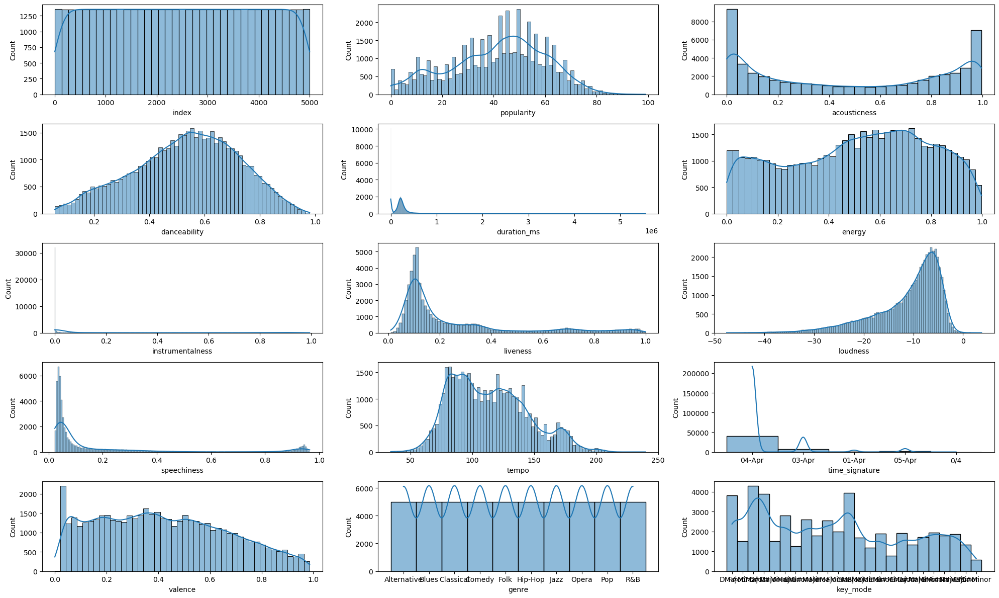

In [19]:
# histogram for feature counts in dataset

fig, axs = plt.subplots(5, 3, figsize=(20, 12))

for i, feature in enumerate(df.columns):
    row = i // 3 
    col = i % 3
    sns.histplot(df[feature], kde=True, ax=axs[row, col])

plt.tight_layout() 
plt.show()


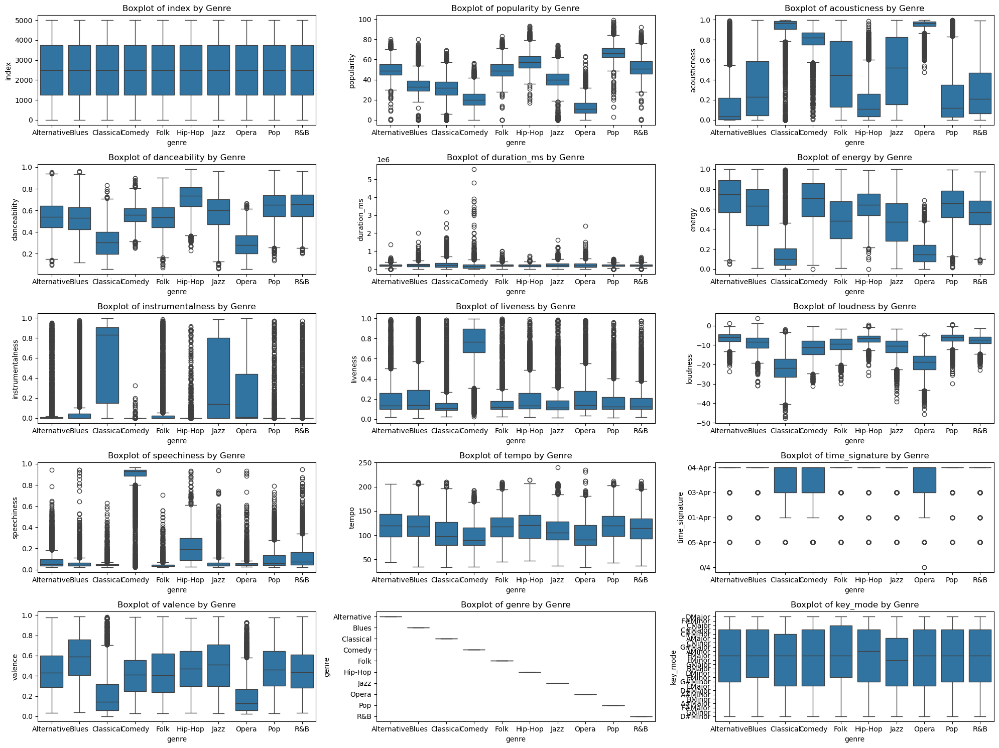

In [20]:
# boxplot for features by genre

fig, axs = plt.subplots(5, 3, figsize=(20, 15))
axs = axs.flatten()

for i, col in enumerate(df.columns):
    sns.boxplot(x='genre', y=col, data=df, ax=axs[i])
    axs[i].set_title(f'Boxplot of {col} by Genre')
    axs[i].set_xticklabels(axs[i].get_xticklabels())

plt.tight_layout()
plt.show()

In [21]:
# check genre value counts to make sure they are symmetric

df['genre'].value_counts()

genre
Alternative    5000
Blues          5000
Classical      5000
Comedy         5000
Folk           5000
Hip-Hop        5000
Jazz           5000
Opera          5000
Pop            5000
R&B            5000
Name: count, dtype: int64

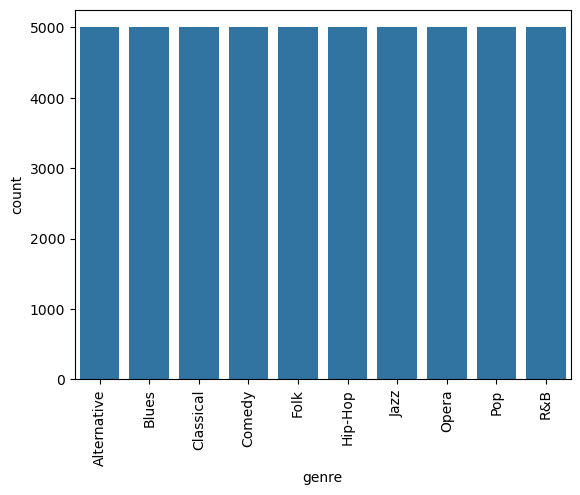

In [22]:
sns.countplot(x='genre', data=df)
plt.xticks(rotation=90)
plt.show()

<Axes: >

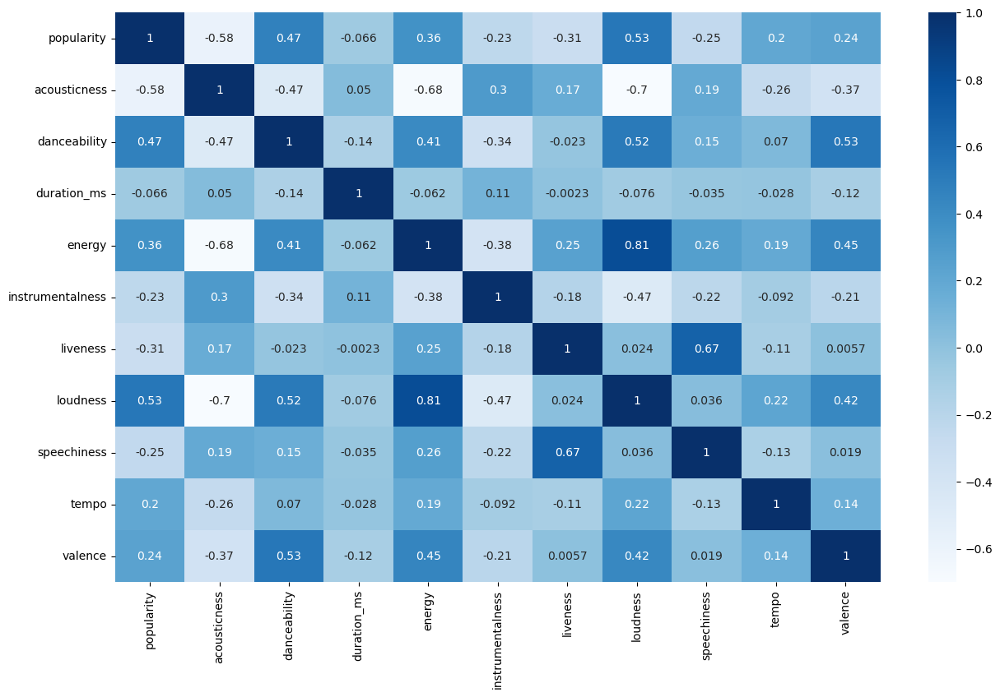

In [23]:
# heatmap for correlation matrix values

fig = plt.figure(figsize = (15,9))
sns.heatmap(corr, cmap='Blues', annot = True)

In [24]:
heatmap_df = df.copy()

# creating another heatmap that includes key_mode, and time_signature as numerical features

le = LabelEncoder()
ts = LabelEncoder()
heatmap_df['key_mode'] = le.fit_transform(heatmap_df['key_mode'])
heatmap_df['time_signature'] = ts.fit_transform(heatmap_df['time_signature'])

heatmap_df.drop(['genre', 'index'], axis=1, inplace=True)

heatmap_df.dtypes

popularity            int64
acousticness        float64
danceability        float64
duration_ms           int64
energy              float64
instrumentalness    float64
liveness            float64
loudness            float64
speechiness         float64
tempo               float64
time_signature        int64
valence             float64
key_mode              int64
dtype: object

<Axes: >

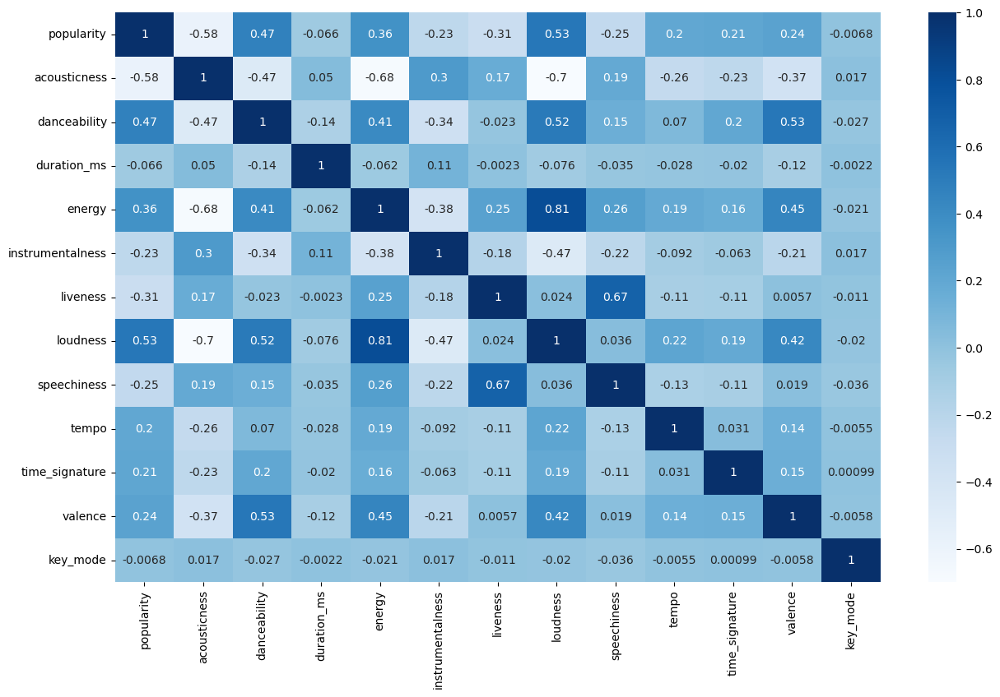

In [25]:
# heatmap for correlation matrix values with key_mode and time_signature

fig = plt.figure(figsize = (15,9))
sns.heatmap(heatmap_df.corr(), cmap='Blues', annot = True)

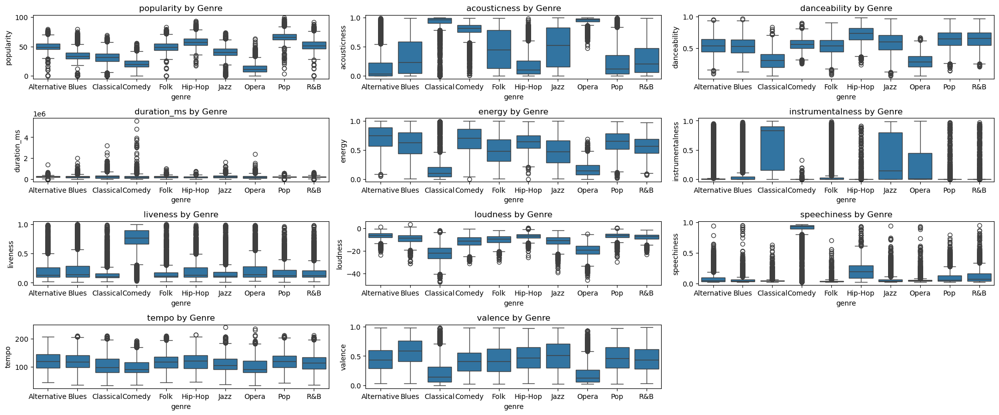

In [26]:
# boxplot for numerical features by genre

plt.figure(figsize=(20, 10))
for i, col in enumerate(numerical.columns):
    plt.subplot(5, 3, i+1)
    sns.boxplot(x='genre', y=col, data=df)
    plt.title(f'{col} by Genre')
plt.tight_layout()
plt.show()

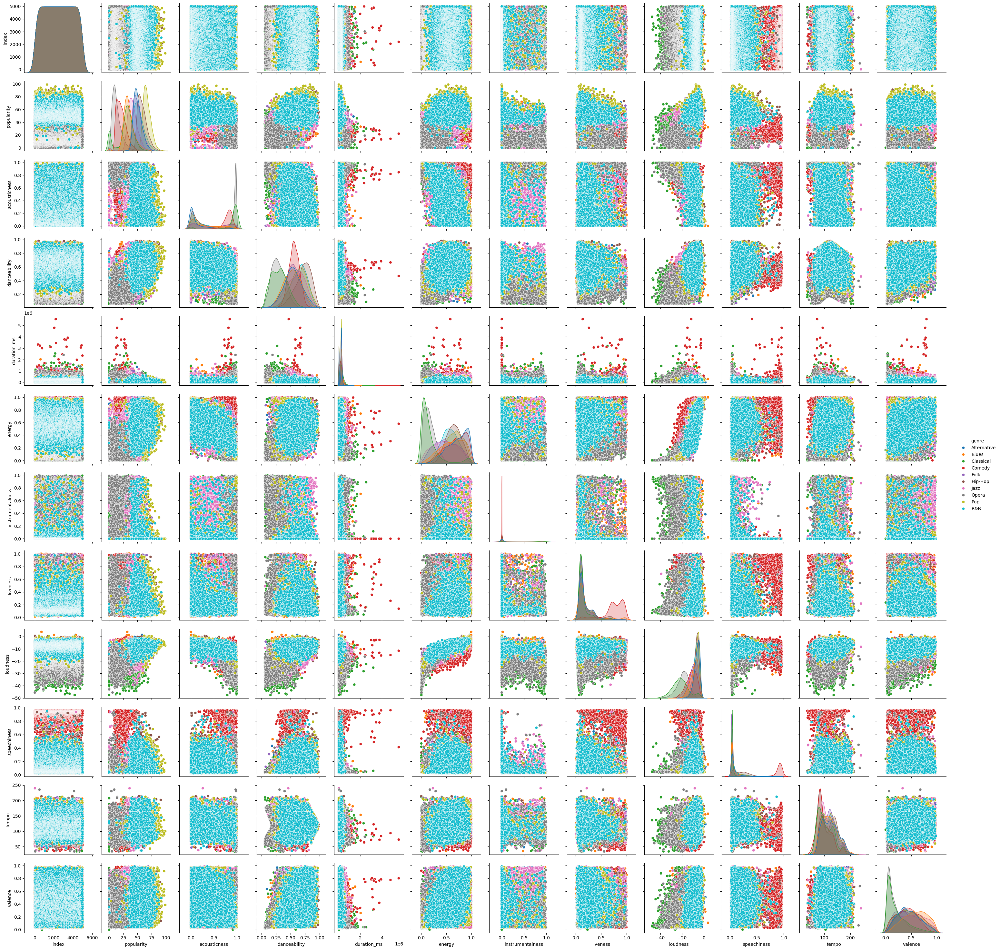

In [27]:
# pairplot for numerical features by genre

sns.pairplot(df, hue='genre')

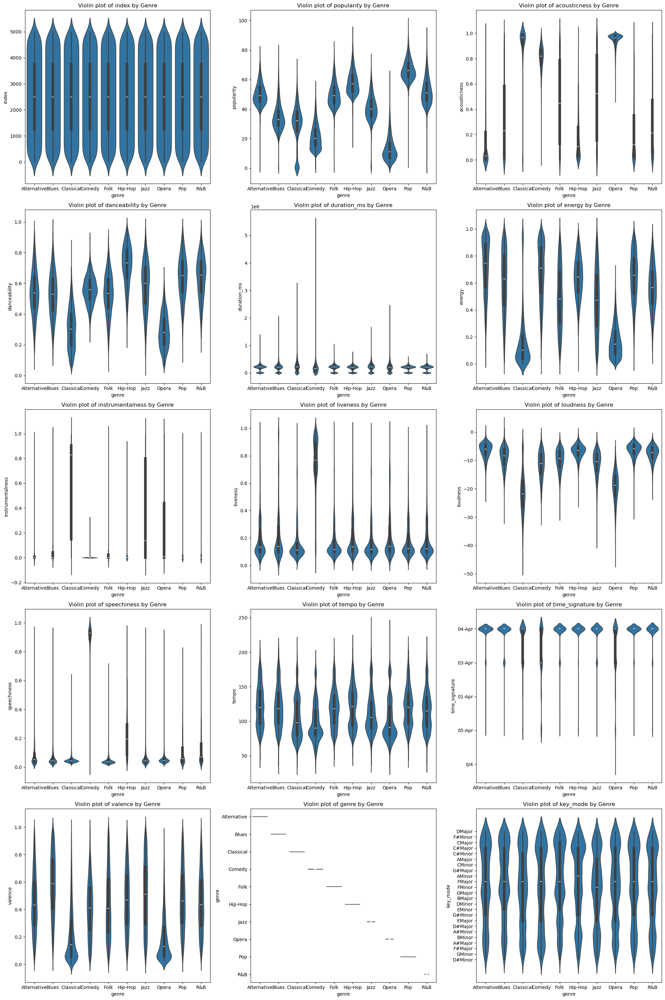

In [28]:
# violin plot for numerical features by genre

fig, axs = plt.subplots(5, 3, figsize=(20, 30))
axs = axs.flatten()

for i, feat in enumerate(df.columns):
    sns.violinplot(x='genre', y=feat, data=df, ax=axs[i])
    axs[i].set_title(f'Violin plot of {feat} by Genre')

plt.tight_layout()
plt.show()

array([[<Axes: title={'center': 'acousticness'}, xlabel='[genre]'>,
        <Axes: title={'center': 'danceability'}, xlabel='[genre]'>,
        <Axes: title={'center': 'duration_ms'}, xlabel='[genre]'>],
       [<Axes: title={'center': 'energy'}, xlabel='[genre]'>,
        <Axes: title={'center': 'index'}, xlabel='[genre]'>,
        <Axes: title={'center': 'instrumentalness'}, xlabel='[genre]'>],
       [<Axes: title={'center': 'liveness'}, xlabel='[genre]'>,
        <Axes: title={'center': 'loudness'}, xlabel='[genre]'>,
        <Axes: title={'center': 'popularity'}, xlabel='[genre]'>],
       [<Axes: title={'center': 'speechiness'}, xlabel='[genre]'>,
        <Axes: title={'center': 'tempo'}, xlabel='[genre]'>,
        <Axes: title={'center': 'valence'}, xlabel='[genre]'>]],
      dtype=object)

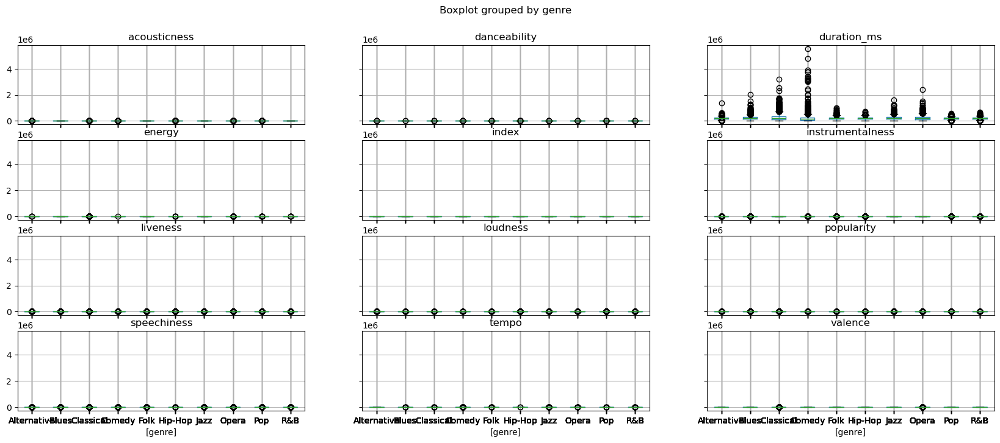

In [29]:
# boxplot for genre by numerical features

df.boxplot(by="genre", figsize=(20, 8))

In [30]:
new_data = df.copy()

# want to look over the data again as scatter plots that include key_mode time_signature genre as numerical

le = LabelEncoder()
ts = LabelEncoder()
ge = LabelEncoder()

new_data['key_mode'] = le.fit_transform(new_data['key_mode'])
new_data['time_signature'] = ts.fit_transform(new_data['time_signature'])
new_data['genre'] = ge.fit_transform(new_data['genre'])

new_data = new_data.drop(columns=['index'])

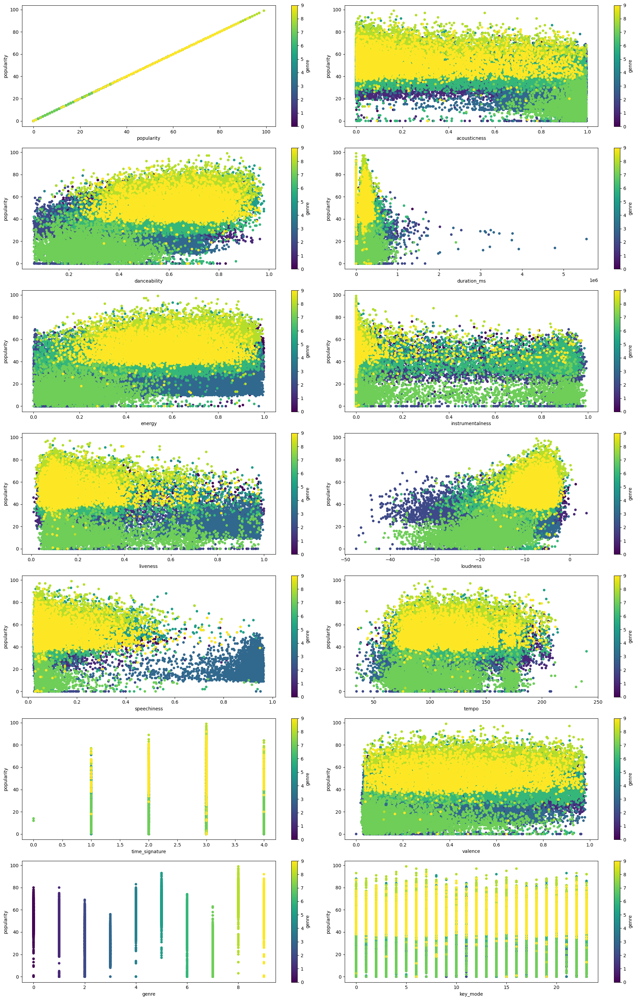

In [31]:
#scatter plot for numerical features by popularity and genre

fig, axs = plt.subplots(7, 2, figsize=(20, 30))

for i in new_data.columns:
    new_data.plot.scatter(x=i, y='popularity', c='genre', colormap='viridis', ax=axs.flatten()[new_data.columns.get_loc(i)])

plt.tight_layout()
plt.show()

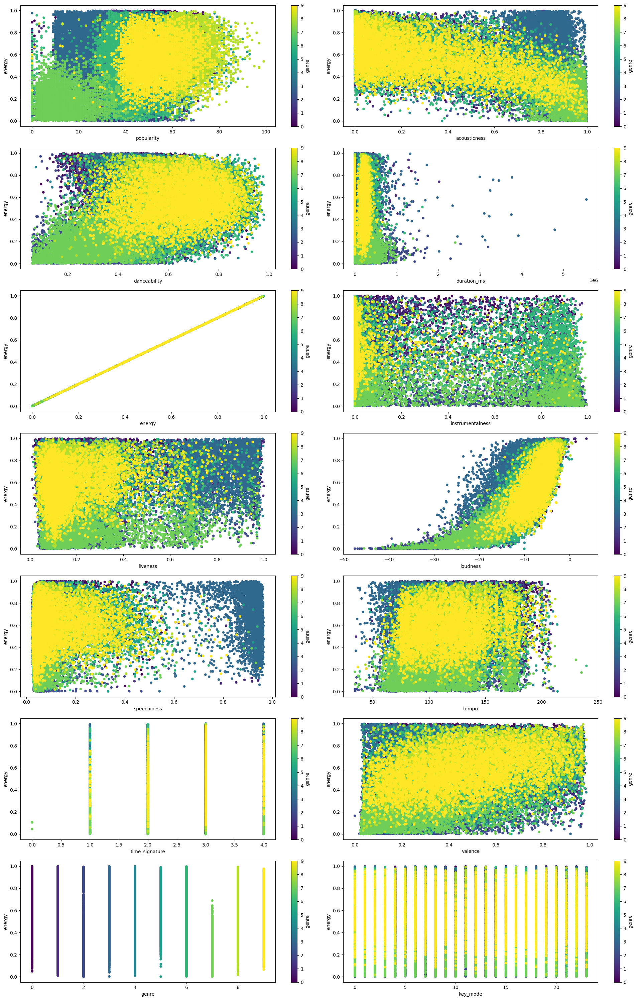

In [32]:
#scatter plot for numerical features by energy and genre

fig, axs = plt.subplots(7, 2, figsize=(20, 30))

for i in new_data.columns:
    new_data.plot.scatter(x=i, y='energy', c='genre', colormap='viridis', ax=axs.flatten()[new_data.columns.get_loc(i)])

plt.tight_layout()
plt.show()

array([[<Axes: title={'center': 'acousticness'}, xlabel='[genre]'>,
        <Axes: title={'center': 'danceability'}, xlabel='[genre]'>,
        <Axes: title={'center': 'energy'}, xlabel='[genre]'>],
       [<Axes: title={'center': 'instrumentalness'}, xlabel='[genre]'>,
        <Axes: title={'center': 'key_mode'}, xlabel='[genre]'>,
        <Axes: title={'center': 'liveness'}, xlabel='[genre]'>],
       [<Axes: title={'center': 'loudness'}, xlabel='[genre]'>,
        <Axes: title={'center': 'popularity'}, xlabel='[genre]'>,
        <Axes: title={'center': 'speechiness'}, xlabel='[genre]'>],
       [<Axes: title={'center': 'tempo'}, xlabel='[genre]'>,
        <Axes: title={'center': 'time_signature'}, xlabel='[genre]'>,
        <Axes: title={'center': 'valence'}, xlabel='[genre]'>]],
      dtype=object)

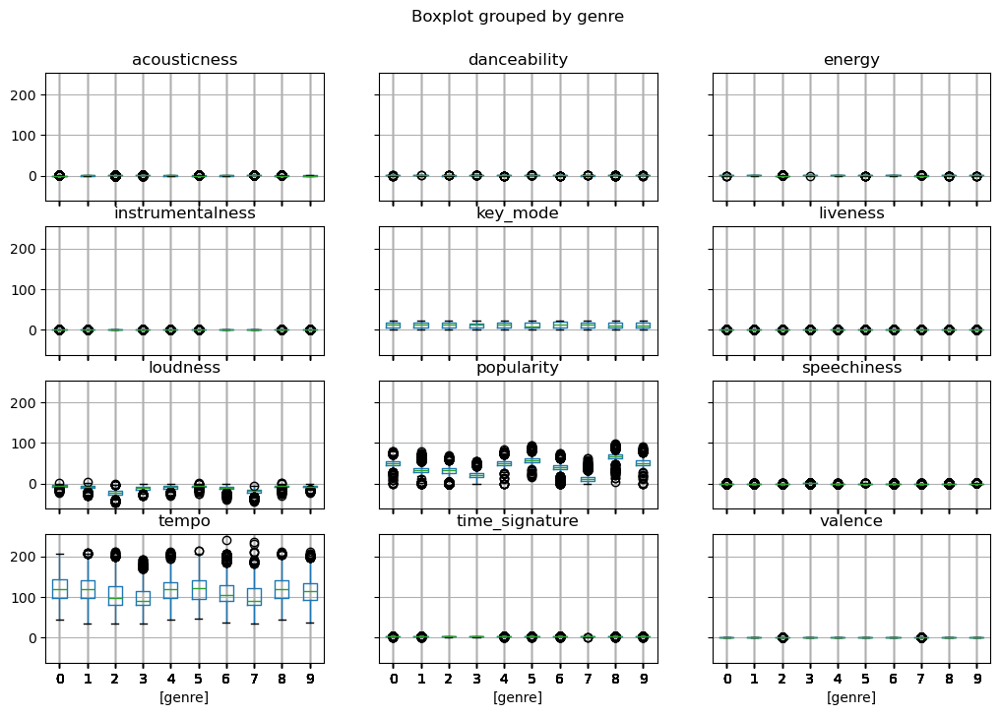

In [33]:
# boxplot for genre by numerical features with duration_ms removed

new_data = new_data.drop(['duration_ms'], axis=1)

new_data.boxplot(by="genre", figsize=(12, 8))

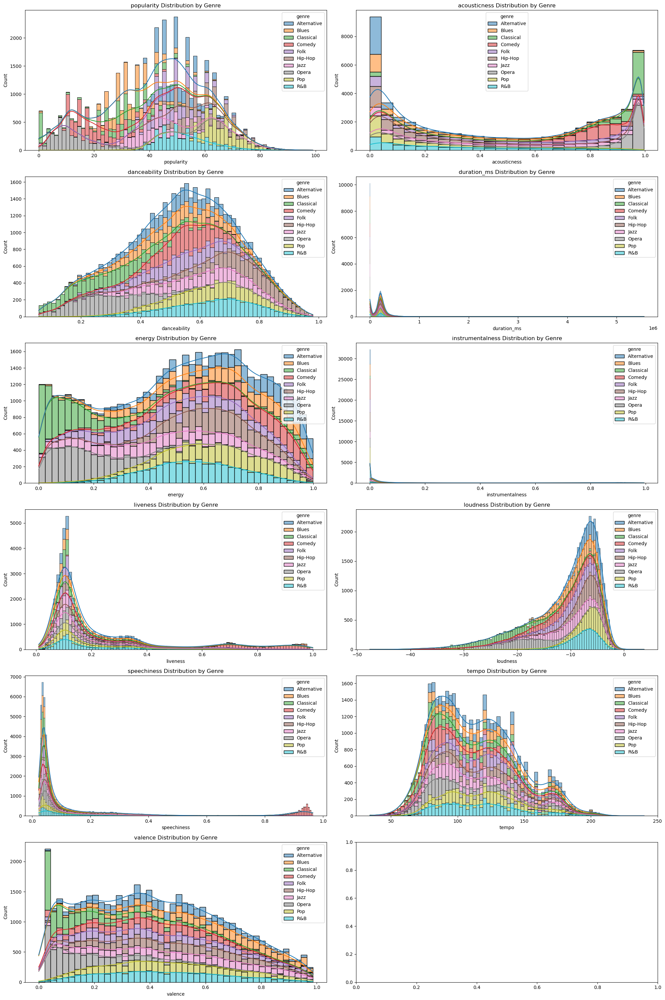

In [34]:
# histogram for numerical features by genre

fig, axs = plt.subplots(6, 2, figsize=(20, 30))

axs = axs.flatten()

for i, col in enumerate(numerical.columns):
    sns.histplot(data=df, x=col, hue='genre', multiple='stack', kde=True, ax=axs[i])
    axs[i].set_title(f'{col} Distribution by Genre')

plt.tight_layout()
plt.show()